In [2]:
import os
fname = os.path.join("cpu_memory_usage_v1.csv")

with open(fname) as f:
    data = f.read()

lines = data.split("\n")
header = lines[0].split(",")
lines = lines[1:]
lines = lines[:len(lines)-2]
print(header)
print(len(lines))
print(lines[:len(lines)])

['name', 'tags', 'time', 'pod_name', 'namespace', 'cpu_usage_nanocores', 'memory_working_set_bytes']
231634
['kubernetes_pod_container,,1678492800000000000,drive-az2-prd-69cbb999bc-wklkm,drive,96624523,1337585664', 'kubernetes_pod_container,,1678492800000000000,drive-az2-prd-69cbb999bc-lpr67,drive,89770983,1361653760', 'kubernetes_pod_container,,1678492800000000000,drive-az2-prd-69cbb999bc-sgr2x,drive,77112631,1285890048', 'kubernetes_pod_container,,1678492800000000000,drive-az2-prd-69cbb999bc-2wdsh,drive,35692946,1254232064', 'kubernetes_pod_container,,1678492800000000000,drive-az2-prd-69cbb999bc-chm2j,drive,93409866,1294434304', 'kubernetes_pod_container,,1678492800000000000,drive-az2-prd-69cbb999bc-h8hqh,drive,69586972,1393459200', 'kubernetes_pod_container,,1678492800000000000,drive-az2-prd-69cbb999bc-gw9xt,drive,91723991,1334177792', 'kubernetes_pod_container,,1678492800000000000,drive-az2-prd-69cbb999bc-wkn2s,drive,68272553,1317998592', 'kubernetes_pod_container,,1678492800000000

In [3]:
import numpy as np
memory = np.zeros((len(lines),))
raw_data = np.zeros((len(lines), 2))
for i, line in enumerate(lines):
    values = [float(x) for x in line.split(",")[len(line.split(","))-2:]]
    print(values)
    memory[i] = values[1]
    raw_data[i, :] = values[:]

[96624523.0, 1337585664.0]
[89770983.0, 1361653760.0]
[77112631.0, 1285890048.0]
[35692946.0, 1254232064.0]
[93409866.0, 1294434304.0]
[69586972.0, 1393459200.0]
[91723991.0, 1334177792.0]
[68272553.0, 1317998592.0]
[56998632.0, 1238155264.0]
[130324748.0, 1455661056.0]
[66125291.0, 1304702976.0]
[88438429.0, 1250349056.0]
[70732211.0, 1304702976.0]
[116873092.0, 1250201600.0]
[88033217.0, 1334050816.0]
[25378572.0, 1285926912.0]
[105979910.0, 1337688064.0]
[104153291.0, 1361588224.0]
[69616188.0, 1393070080.0]
[54968996.0, 1283493888.0]
[60763677.0, 1296531456.0]
[143954147.0, 1455157248.0]
[78094815.0, 1334718464.0]
[57098487.0, 1238155264.0]
[68160743.0, 1334738944.0]
[41232708.0, 1238155264.0]
[67892096.0, 1393053696.0]
[98382776.0, 1337208832.0]
[60382912.0, 1304702976.0]
[99283237.0, 1251385344.0]
[108151911.0, 1368113152.0]
[54979977.0, 1285926912.0]
[75696618.0, 1336766464.0]
[105269878.0, 1455472640.0]
[111036926.0, 1283665920.0]
[76771766.0, 1296531456.0]
[75430461.0, 1283551

from matplotlib import pyplot as plt
plt.plot(range(len(memory)), memory)
plt.show()

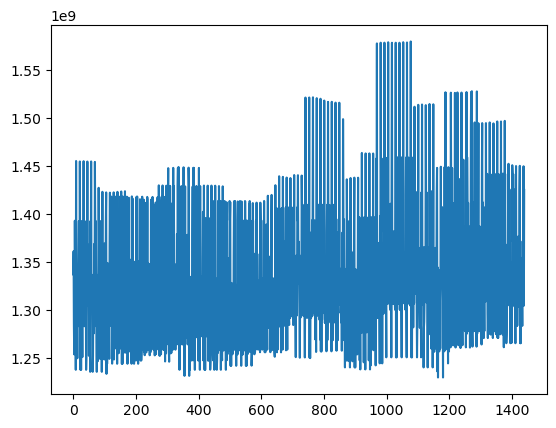

In [5]:
import matplotlib.pyplot as plt
plt.plot(range(1440), memory[:1440])
plt.show()

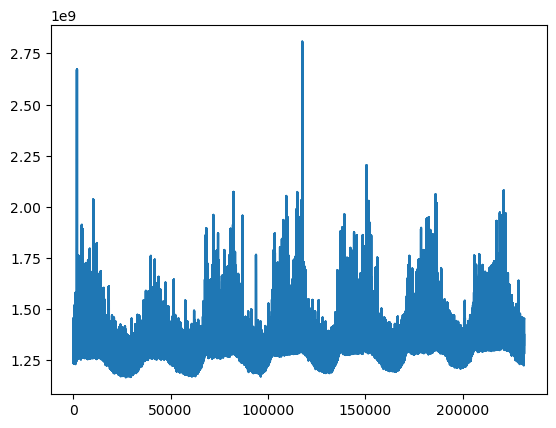

In [6]:
plt.plot(range(len(memory)), memory)
plt.show()

In [7]:
num_train_samples = int(0.5 * len(raw_data))
num_val_samples = int(0.25 * len(raw_data))
num_test_samples = len(raw_data) - num_train_samples - num_val_samples
print("num_train_samples:", num_train_samples)
print("num_val_samples:", num_val_samples)
print("num_test_samples:", num_test_samples)

num_train_samples: 115817
num_val_samples: 57908
num_test_samples: 57909


In [8]:
mean = raw_data[:num_train_samples].mean(axis=0)
raw_data -= mean
std = raw_data[:num_train_samples].std(axis=0)
raw_data /= std

In [9]:
import numpy as np
from tensorflow import keras
int_sequence = np.arange(10)
dummy_dataset = keras.utils.timeseries_dataset_from_array(
    data=int_sequence[:-3],
    targets=int_sequence[3:],
    sequence_length=3,
    batch_size=2,
)

for inputs, targets in dummy_dataset:
    for i in range(inputs.shape[0]):
        print([int(x) for x in inputs[i]], int(targets[i]))

[0, 1, 2] 3
[1, 2, 3] 4
[2, 3, 4] 5
[3, 4, 5] 6
[4, 5, 6] 7


2023-03-27 18:09:04.283160: W tensorflow/core/platform/profile_utils/cpu_utils.cc:128] Failed to get CPU frequency: 0 Hz


In [10]:
sampling_rate = 6
sequence_length = 120
delay = sampling_rate * (sequence_length + 24 - 1)
batch_size = 256

train_dataset = keras.utils.timeseries_dataset_from_array(
    raw_data[:-delay],
    targets=memory[delay:],
    sampling_rate=sampling_rate,
    sequence_length=sequence_length,
    shuffle=True,
    batch_size=batch_size,
    start_index=0,
    end_index=num_train_samples)

val_dataset = keras.utils.timeseries_dataset_from_array(
    raw_data[:-delay],
    targets=memory[delay:],
    sampling_rate=sampling_rate,
    sequence_length=sequence_length,
    shuffle=True,
    batch_size=batch_size,
    start_index=num_train_samples,
    end_index=num_train_samples + num_val_samples)

test_dataset = keras.utils.timeseries_dataset_from_array(
    raw_data[:-delay],
    targets=memory[delay:],
    sampling_rate=sampling_rate,
    sequence_length=sequence_length,
    shuffle=True,
    batch_size=batch_size,
    start_index=num_train_samples + num_val_samples)

In [34]:
for samples, targets in test_dataset:
    print("샘플 크기:", samples.shape)
    print("타깃 크기:", targets.shape)
    break

샘플 크기: (256, 120, 2)
타깃 크기: (256,)


In [11]:
def evaluate_naive_method(dataset):
    total_abs_err = 0.
    samples_seen = 0
    for samples, targets in dataset:
        preds = samples[:, -1, 1] * std[1] + mean[1]
        total_abs_err += np.sum(np.abs(preds - targets))
        samples_seen += samples.shape[0]
    return total_abs_err / samples_seen

print(f"검증 MAE: {evaluate_naive_method(val_dataset):.2f}")
print(f"테스트 MAE: {evaluate_naive_method(test_dataset):.2f}")

검증 MAE: 71824609.31
테스트 MAE: 75966391.00


In [12]:
from tensorflow import keras
from tensorflow.keras import layers

inputs = keras.Input(shape=(sequence_length, raw_data.shape[-1]))
x = layers.Flatten()(inputs)
x = layers.Dense(16, activation="relu")(x)
outputs = layers.Dense(1)(x)
model = keras.Model(inputs, outputs)

callbacks = [
    keras.callbacks.ModelCheckpoint("jena_dense.keras",
                                    save_best_only=True)
]
model.compile(optimizer="rmsprop", loss="mse", metrics=["mae"])
history = model.fit(train_dataset,
                    epochs=10,
                    validation_data=val_dataset,
                    callbacks=callbacks)

model = keras.models.load_model("jena_dense.keras")
print(f"테스트 MAE: {model.evaluate(test_dataset)[1]:.2f}")

Epoch 1/10
450/450 [==============================] - 6s 13ms/step - loss: 1812967955487522816.0000 - mae: 1342961024.0000 - val_loss: 1869106407861649408.0000 - val_mae: 1363356288.0000
Epoch 2/10
450/450 [==============================] - 6s 13ms/step - loss: 1812966855975895040.0000 - mae: 1342959744.0000 - val_loss: 1869104896033161216.0000 - val_mae: 1363354624.0000
Epoch 3/10
450/450 [==============================] - 6s 13ms/step - loss: 1812964931830546432.0000 - mae: 1342958464.0000 - val_loss: 1869102422131998720.0000 - val_mae: 1363353472.0000
Epoch 4/10
450/450 [==============================] - 7s 15ms/step - loss: 1812960946100895744.0000 - mae: 1342957440.0000 - val_loss: 1869096237379092480.0000 - val_mae: 1363352064.0000
Epoch 5/10
450/450 [==============================] - 7s 14ms/step - loss: 1812956135737524224.0000 - mae: 1342954752.0000 - val_loss: 1869091427015720960.0000 - val_mae: 1363349504.0000
Epoch 6/10
450/450 [==============================] - 6s 14ms/ste

In [42]:

for samples, targets in test_dataset:
    sample = samples
    print(samples.shape)
    pred = model.predict(samples)
    break

(256, 120, 2)
8/8 [==============================] - 0s 402us/step


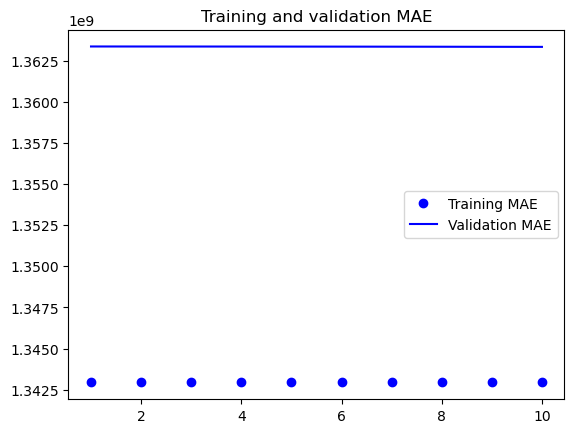

In [14]:
import matplotlib.pyplot as plt
loss = history.history["mae"]
val_loss = history.history["val_mae"]
epochs = range(1, len(loss) + 1)
plt.figure()
plt.plot(epochs, loss, "bo", label="Training MAE")
plt.plot(epochs, val_loss, "b", label="Validation MAE")
plt.title("Training and validation MAE")
plt.legend()
plt.show()

ValueError: x and y can be no greater than 2D, but have shapes (256,) and (256, 120, 2)

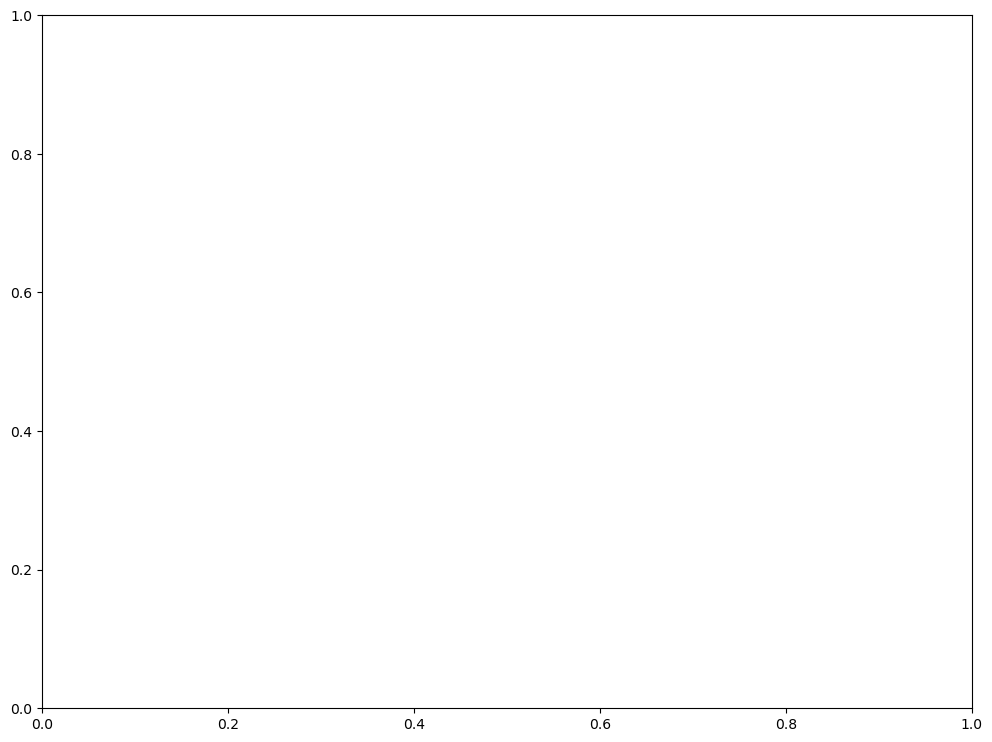

In [39]:
plt.figure(figsize=(12, 9))
plt.plot(sample, label = 'actual')
plt.plot(pred, label = 'prediction')
plt.legend()
plt.show()

In [191]:
inputs = keras.Input(shape=(sequence_length, raw_data.shape[-1]))
x = layers.Conv1D(8, 24, activation="relu")(inputs)
x = layers.MaxPooling1D(2)(x)
x = layers.Conv1D(8, 12, activation="relu")(x)
x = layers.MaxPooling1D(2)(x)
x = layers.Conv1D(8, 6, activation="relu")(x)
x = layers.GlobalAveragePooling1D()(x)
outputs = layers.Dense(1)(x)
model = keras.Model(inputs, outputs)

callbacks = [
    keras.callbacks.ModelCheckpoint("jena_conv.keras",
                                    save_best_only=True)
]
model.compile(optimizer="rmsprop", loss="mse", metrics=["mae"])
history = model.fit(train_dataset,
                    epochs=10,
                    validation_data=val_dataset,
                    callbacks=callbacks)

model = keras.models.load_model("jena_conv.keras")
print(f"테스트 MAE: {model.evaluate(test_dataset)[1]:.2f}")

Epoch 1/10
450/450 [==============================] - 9s 19ms/step - loss: 1812949538667757568.0000 - mae: 1342953600.0000 - val_loss: 1869018309492473856.0000 - val_mae: 1363324416.0000
Epoch 2/10
450/450 [==============================] - 9s 19ms/step - loss: 1812635765536980992.0000 - mae: 1342839936.0000 - val_loss: 1868207969422802944.0000 - val_mae: 1363037440.0000
Epoch 3/10
450/450 [==============================] - 9s 19ms/step - loss: 1811176301290061824.0000 - mae: 1342313216.0000 - val_loss: 1865346078094655488.0000 - val_mae: 1362023808.0000
Epoch 4/10
450/450 [==============================] - 8s 18ms/step - loss: 1807145354223681536.0000 - mae: 1340854016.0000 - val_loss: 1858450490921058304.0000 - val_mae: 1359575808.0000
Epoch 5/10
450/450 [==============================] - 8s 18ms/step - loss: 1798556381704355840.0000 - mae: 1337735808.0000 - val_loss: 1844905469739532288.0000 - val_mae: 1354743936.0000
Epoch 6/10
450/450 [==============================] - 8s 18ms/ste

In [ ]:
loss = history.history["mae"]
val_loss = history.history["val_mae"]
epochs = range(1, len(loss) + 1)
plt.figure()
plt.plot(epochs, loss, "bo", label="Training MAE")
plt.plot(epochs, val_loss, "b", label="Validation MAE")
plt.title("Training and validation MAE")
plt.legend()
plt.show()